# Horizon plots of ILS proportions

In [1]:
%matplotlib inline

import numpy as np
import pandas as pd
from pandas import DataFrame, Series
import warnings
from scipy import signal, stats
from statsmodels.nonparametric.smoothers_lowess import lowess

from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina', 'png')

import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Rectangle
from matplotlib.lines import Line2D

import mpld3

from horizonplot import horizonplot
from chromwindow import window

import seaborn as sns
sns.set()
sns.set_style("ticks")
sns.set_context("notebook")

def add_band(x_low, x_high, y_low=None, y_high=None, ax=None, color='gray', linewidth=0, alpha=0.5, zorder=0, **kwargs):
    "Plot a gray block on x interval"
    if ax is None:
        ax = plt.gca()
    if y_low is None:
        y_low, _ = ax.get_ylim()
    if y_high is None:
        _, y_high = ax.get_ylim()
    g = ax.add_patch(Rectangle((x_low, y_low), x_high-x_low, y_high-y_low, 
                 facecolor=color,
                 linewidth=linewidth,
                 alpha=alpha,
                 zorder=zorder,
                 **kwargs))

def stairs(df, start='start', end='end', pos='pos', endtrim=0):
    "Turn a df with start, end into one with pos to plot as stairs"
    df1 = df.copy(deep=True)
    df2 = df.copy(deep=True)
    df1[pos] = df1[start]
    df2[pos] = df2[end] - endtrim
    return pd.concat([df1, df2]).sort_values([start, end])

# My own paired palette replacing the last brown pair with violets
sns.color_palette('Paired').as_hex()
Paired = sns.color_palette(['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c', '#fb9a99', '#e31a1c',
                            '#fdbf6f', '#ff7f00', '#cab2d6','#6a3d9a', '#e585cf', '#ad009d'])
#sns.palplot(Paired)
Infographics = sns.color_palette(['#e8615d', '#f49436', '#2d9de5', '#3bbdbd', '#634792'])
#sns.palplot(Infographics)

chromosomes = list(map(str, range(1,23))) + ['X']

In [2]:
%%html
<style> table { font-variant-numeric: tabular-nums; } </style>

## Load ILS data

HDF is written in `nb01_compile_ils_data.ipynb`:

In [3]:
ils_data = pd.read_hdf('../results/ils_data.h5')
ils_data.head()

,chrom,start,end,analysis,V0,V1,V2,V3,tot_segment,propils,ilsskew,propils_z_score,ilsskew_z_score,names
0,1,0,100000,AOTNAN_SAGMID_CEBALB_HOMSAP,0,0,0,0,0,NaN,NaN,NaN,NaN,Aotus_nancymaae Saguinus_midas Cebus_albifrons...
1,1,100000,200000,AOTNAN_SAGMID_CEBALB_HOMSAP,0,0,0,0,0,NaN,NaN,NaN,NaN,Aotus_nancymaae Saguinus_midas Cebus_albifrons...
2,1,200000,300000,AOTNAN_SAGMID_CEBALB_HOMSAP,0,0,0,0,0,NaN,NaN,NaN,NaN,Aotus_nancymaae Saguinus_midas Cebus_albifrons...
3,1,300000,400000,AOTNAN_SAGMID_CEBALB_HOMSAP,0,0,0,0,0,NaN,NaN,NaN,NaN,Aotus_nancymaae Saguinus_midas Cebus_albifrons...
4,1,400000,500000,AOTNAN_SAGMID_CEBALB_HOMSAP,0,0,0,0,0,NaN,NaN,NaN,NaN,Aotus_nancymaae Saguinus_midas Cebus_albifrons...


## Horizon plots

In [4]:
def horizon_plot_set(chrom, interval=None):
    if interval is not None:
        df = ils_data.loc[(ils_data.chrom == chrom) & (ils_data.start >= interval[0]) & (ils_data.end < interval[1])]
    else:
        df = ils_data.loc[(ils_data.chrom == chrom)]
    fig = horizonplot(df, 'propils', width=1, col='chrom', row='names', size=0.3, aspect=100)
    fig.suptitle('ILS proportion (cut:auto)', fontsize=20, y=0.91)
    plt.show()

### Chromosome 1

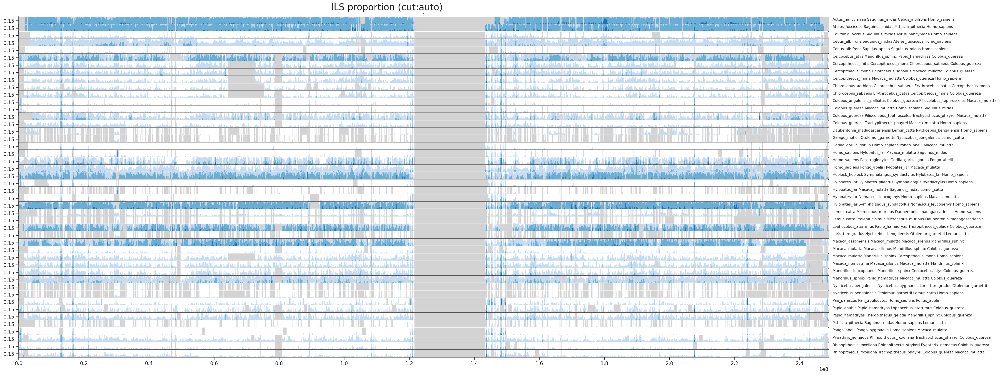

In [5]:
horizon_plot_set('1')

### Chromosome 2

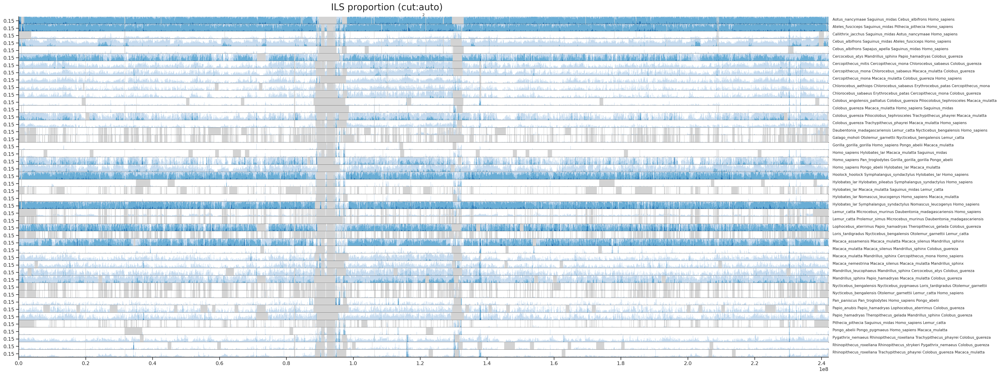

In [6]:
horizon_plot_set('2')

### Chromosome 3

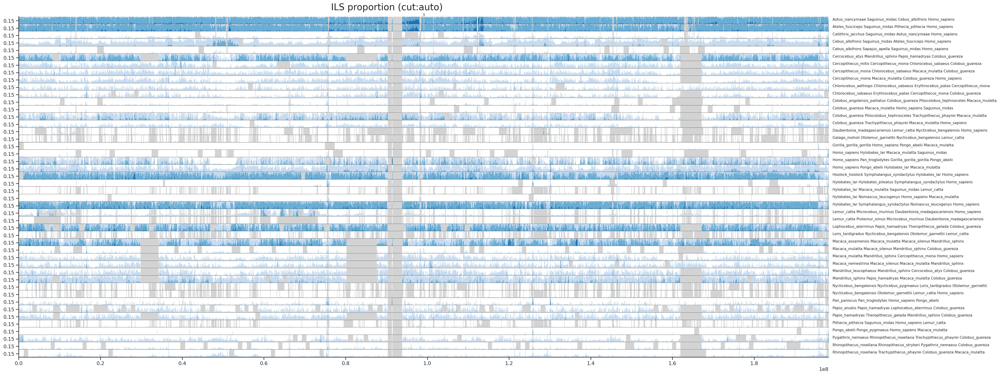

In [7]:
horizon_plot_set('3')

### Chromosome 3 region detail

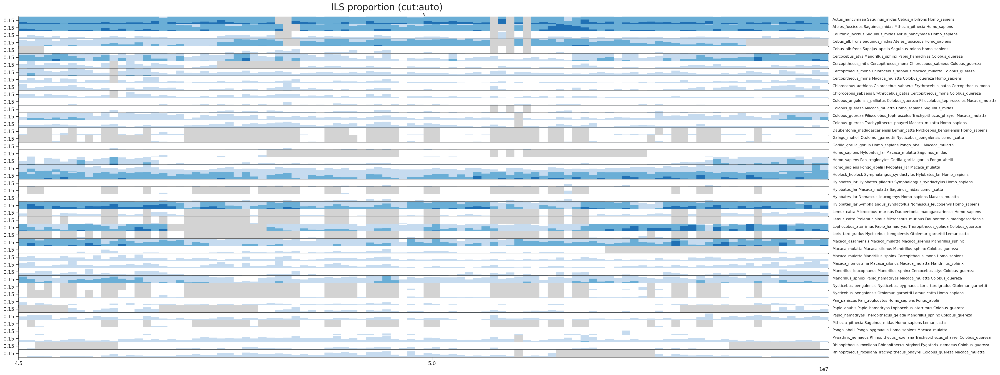

In [8]:
horizon_plot_set('3', interval=(45e6, 55e6))

### Chromosome 4

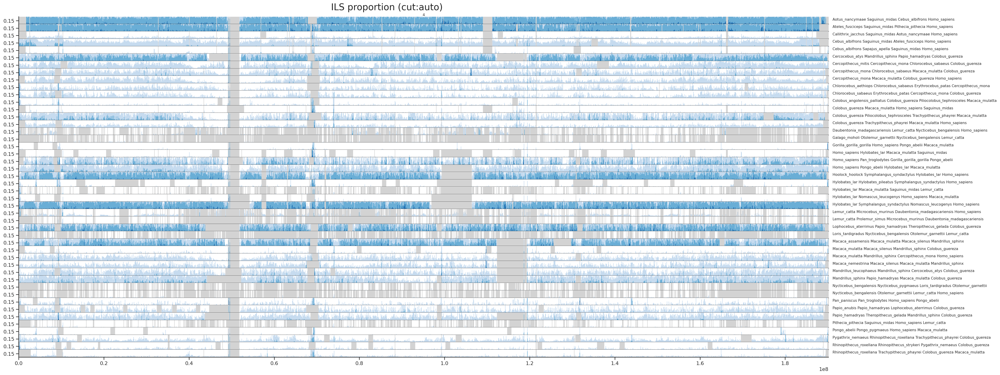

In [9]:
horizon_plot_set('4')

### Chromosome 5

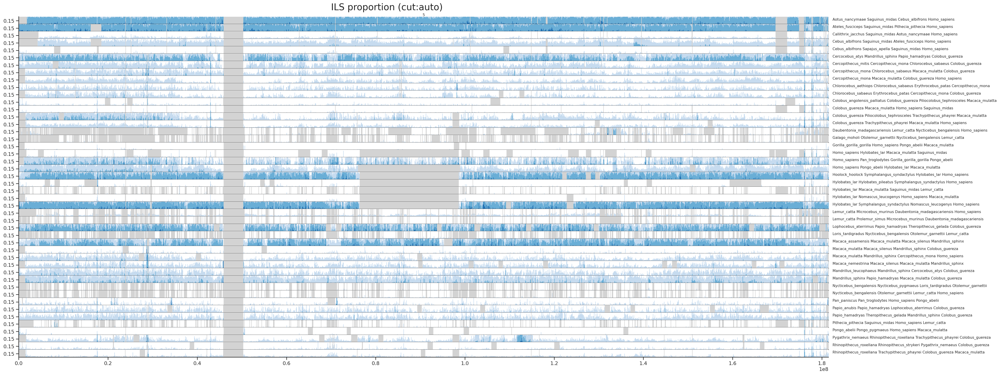

In [10]:
horizon_plot_set('5')

### Chromosome 6

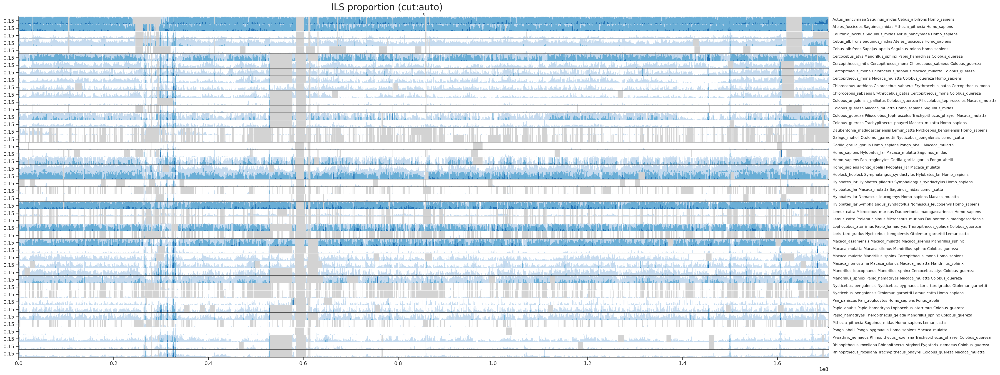

In [11]:
horizon_plot_set('6')

### Chromosome 7

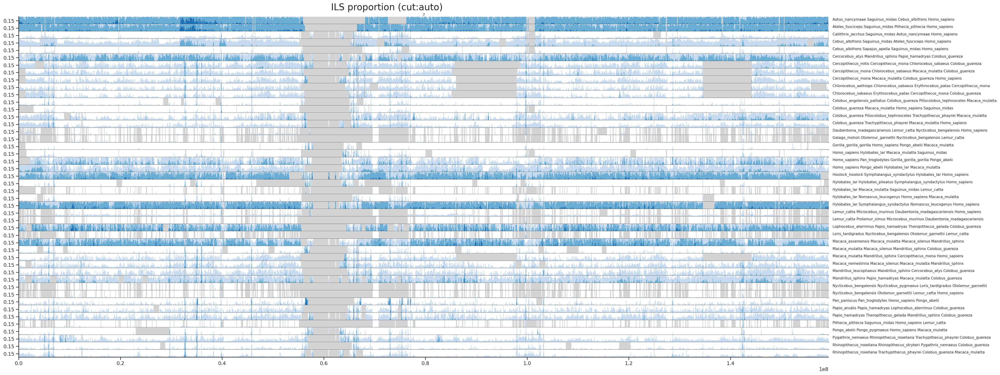

In [12]:
horizon_plot_set('7')

### Chromosome 8

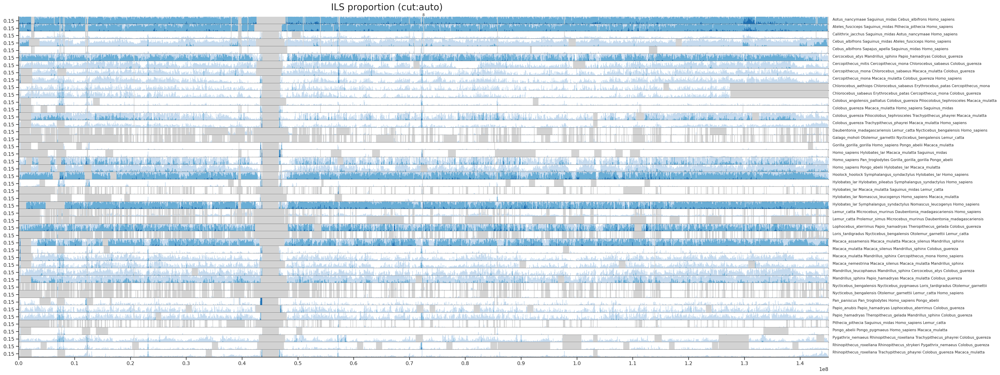

In [13]:
horizon_plot_set('8')

### Chromosome 9

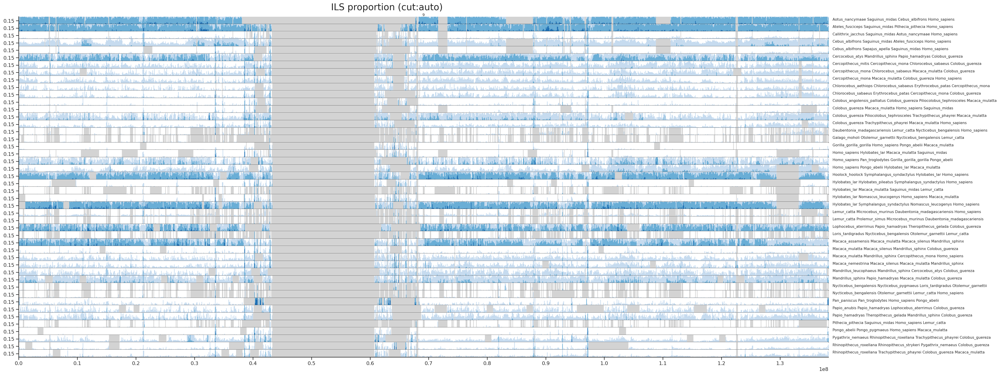

In [14]:
horizon_plot_set('9')

### Chromosome 10

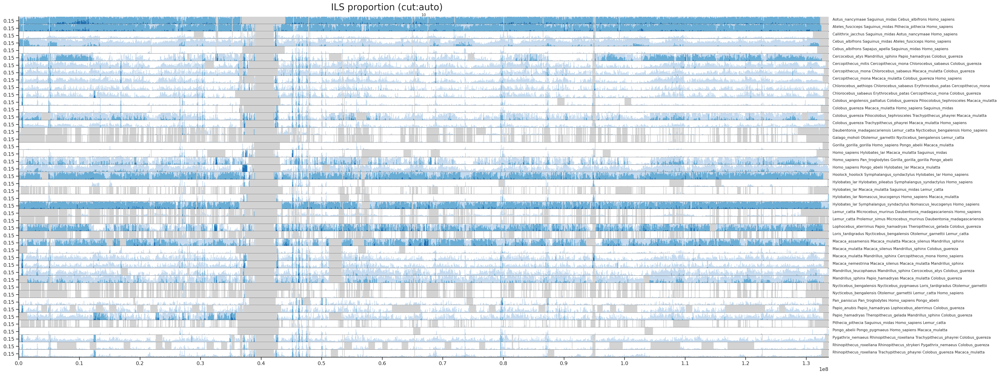

In [15]:
horizon_plot_set('10')

### Chromosome 11

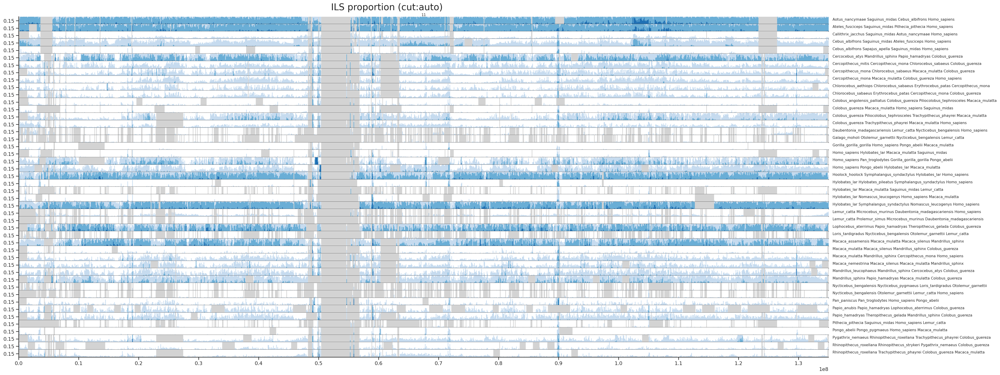

In [16]:
horizon_plot_set('11')

### Chromosome 12

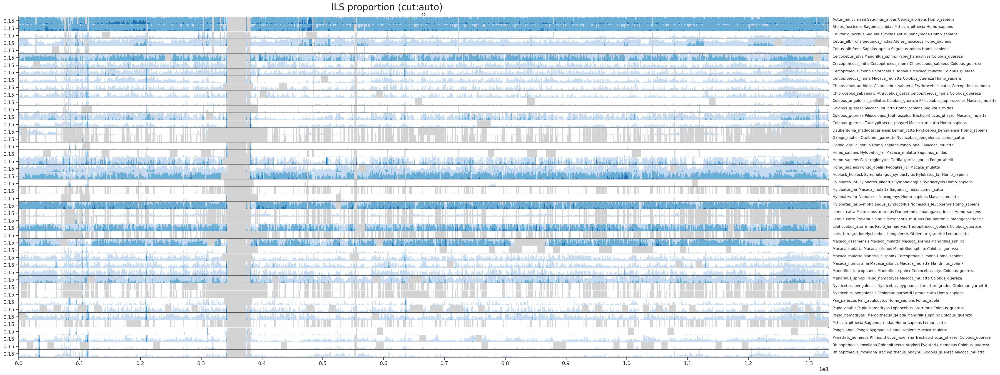

In [17]:
horizon_plot_set('12')

### Chromosome 13

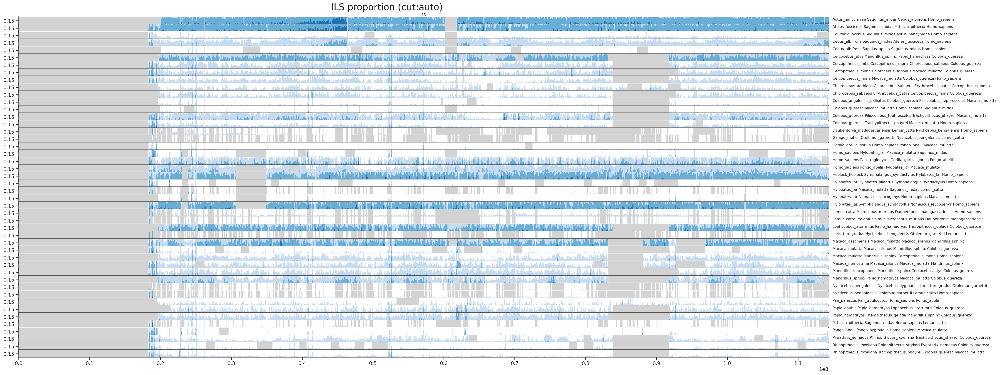

In [18]:
horizon_plot_set('13')

### Chromosome 14

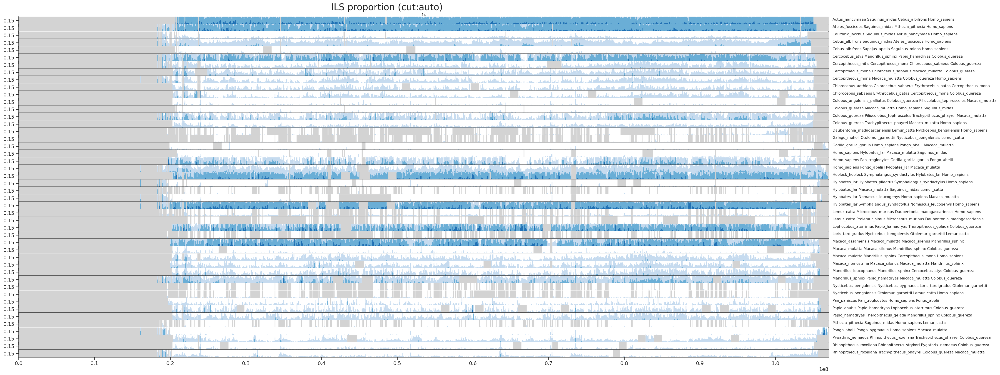

In [19]:
horizon_plot_set('14')

### Chromosome 15

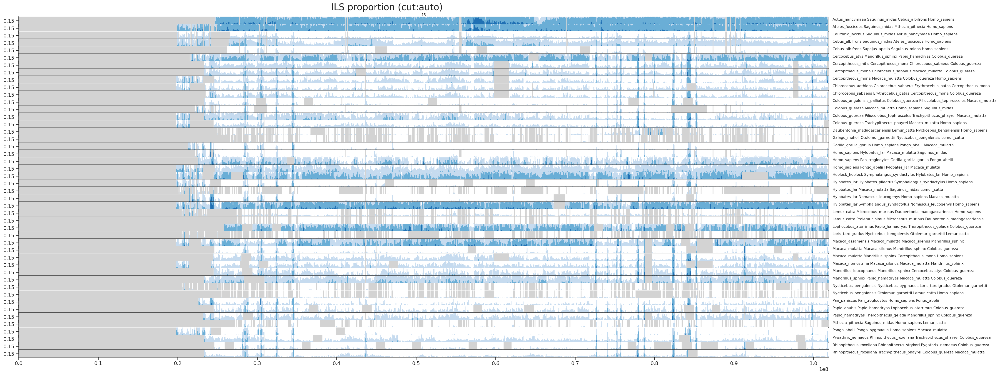

In [20]:
horizon_plot_set('15')

### Chromosome 16

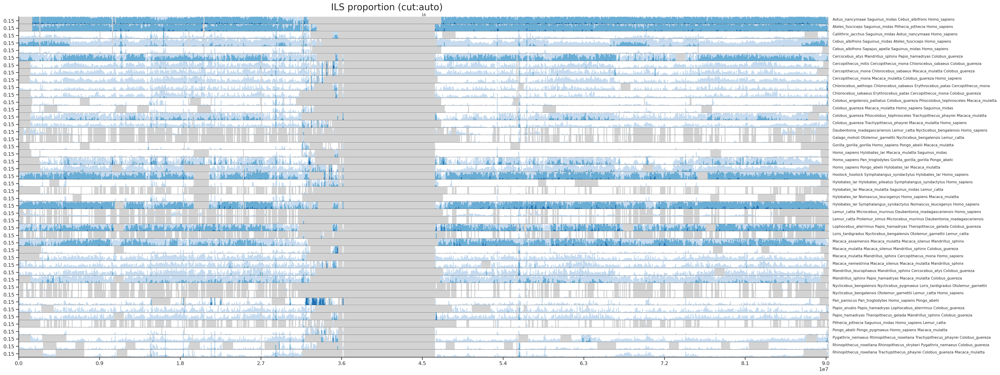

In [21]:
horizon_plot_set('16')

### Chromosome 17

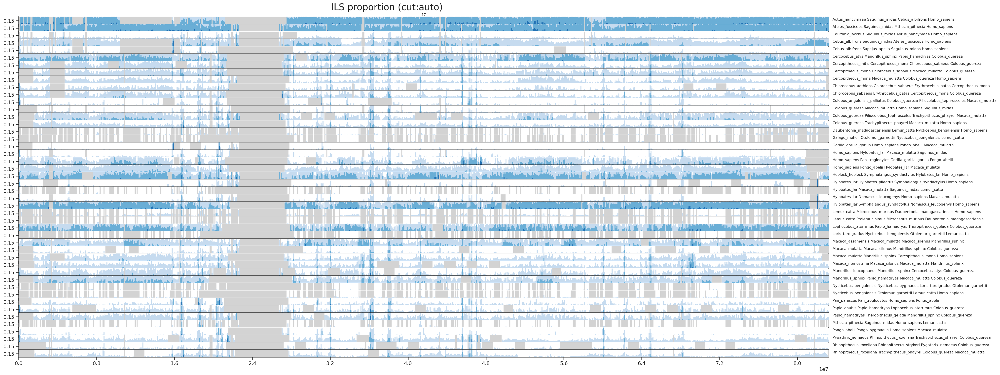

In [22]:
horizon_plot_set('17')

### Chromosome 18

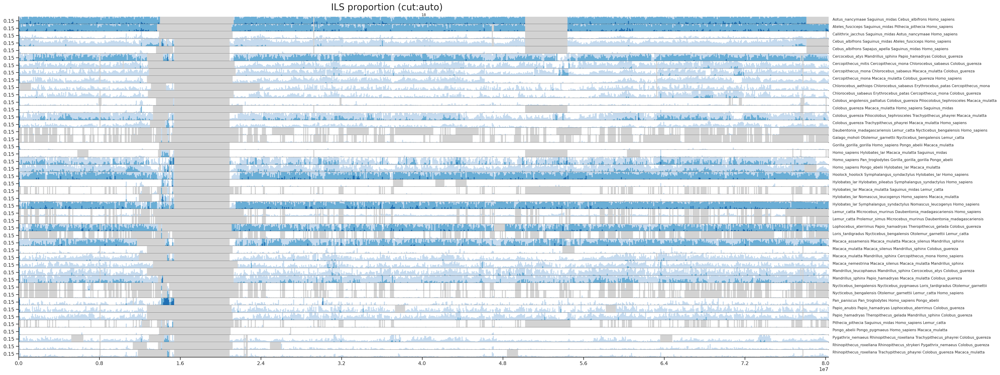

In [23]:
horizon_plot_set('18')

### Chromosome 19

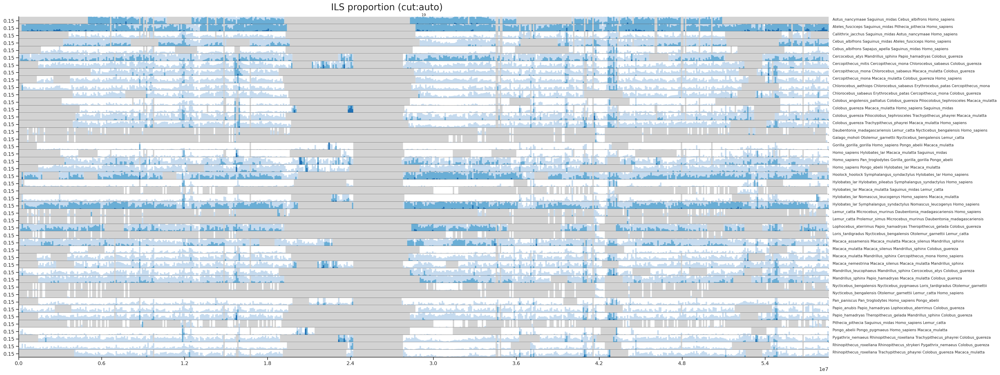

In [24]:
horizon_plot_set('19')

### Chromosome 20

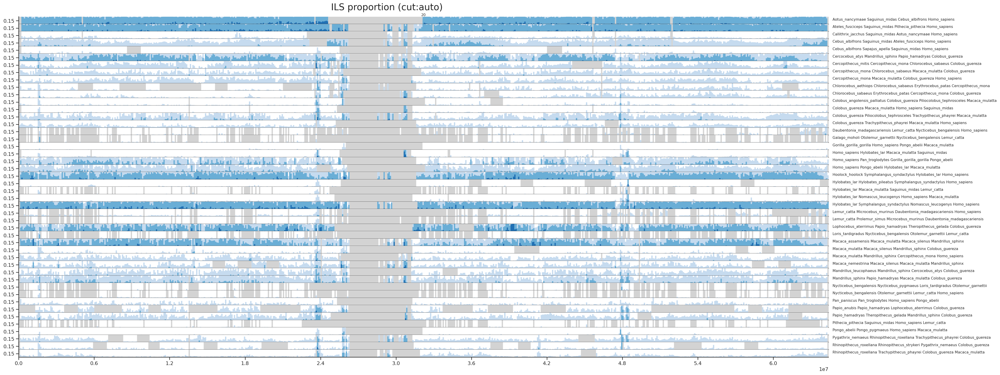

In [25]:
horizon_plot_set('20')

### Chromosome 21

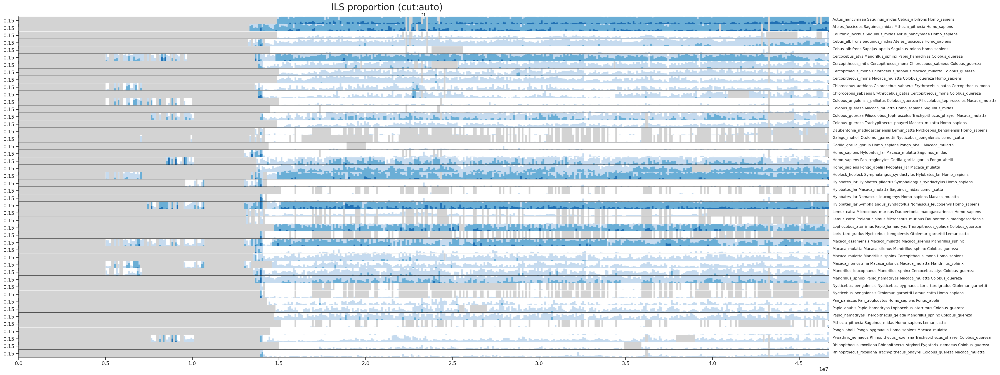

In [26]:
horizon_plot_set('21')

### Chromosome 22

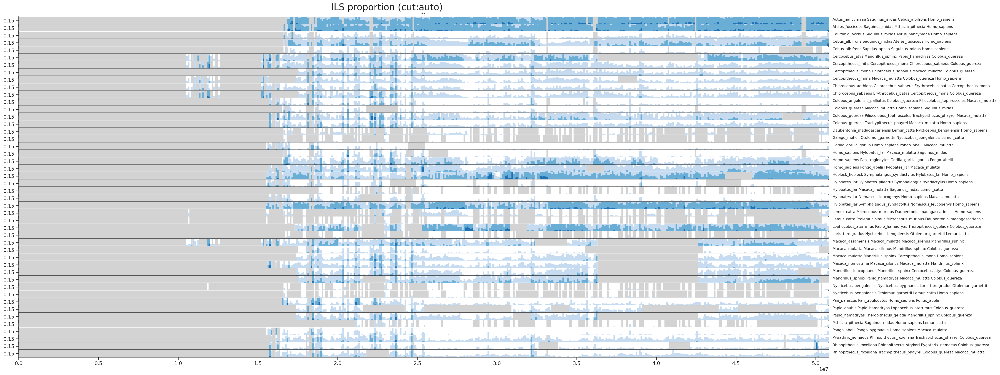

In [27]:
horizon_plot_set('22')

### Chromosome X

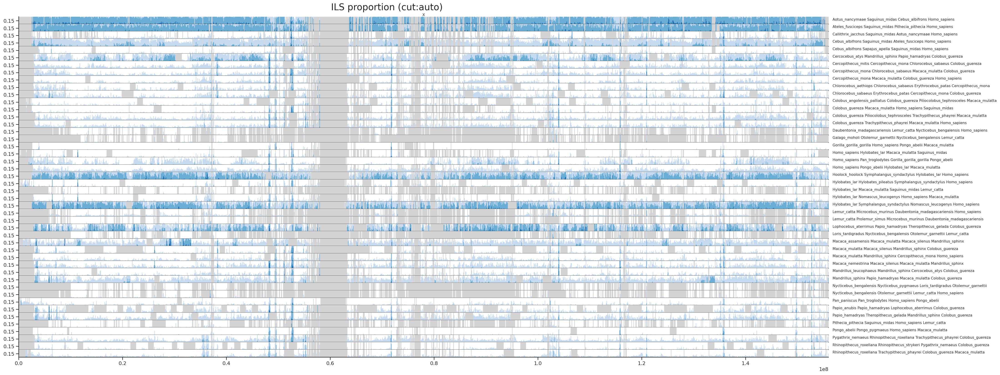

In [28]:
horizon_plot_set('X')